In [1]:
import numpy as np
import pandas as pd 
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import os

%matplotlib inline

## Initial Exploration of Individual Monthly Trip History

**June 2013** and **January 2019**

In [2]:
jan19 = pd.read_csv('../citibike_data/trip_history/201901-citibike-tripdata.csv')


In [3]:
june13 = pd.read_csv('../citibike_data/trip_history/2013-06 - Citi Bike trip data.csv')

In [4]:
jan19.columns

Index(['tripduration', 'starttime', 'stoptime', 'start station id',
       'start station name', 'start station latitude',
       'start station longitude', 'end station id', 'end station name',
       'end station latitude', 'end station longitude', 'bikeid', 'usertype',
       'birth year', 'gender'],
      dtype='object')

In [5]:
june13.columns == jan19.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True])

In [6]:
print(' Jan 2019: ', jan19.shape)
print('June 2013: ', june13.shape)

 Jan 2019:  (967287, 15)
June 2013:  (577703, 15)


In [7]:
jan19.dtypes

tripduration                 int64
starttime                   object
stoptime                    object
start station id           float64
start station name          object
start station latitude     float64
start station longitude    float64
end station id             float64
end station name            object
end station latitude       float64
end station longitude      float64
bikeid                       int64
usertype                    object
birth year                   int64
gender                       int64
dtype: object

In [8]:
jan19.sample(5)

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,birth year,gender
361414,291,2019-01-11 08:37:33.2780,2019-01-11 08:42:24.3580,3165.0,Central Park West & W 72 St,40.775794,-73.976206,2006.0,Central Park S & 6 Ave,40.765909,-73.976342,20651,Subscriber,1978,1
291821,212,2019-01-09 13:07:50.6910,2019-01-09 13:11:23.0920,397.0,Fulton St & Clermont Ave,40.684157,-73.969223,3429.0,Hanson Pl & Ashland Pl,40.685068,-73.977908,25457,Subscriber,1992,1
10111,363,2019-01-01 14:22:51.8170,2019-01-01 14:28:54.9640,491.0,E 24 St & Park Ave S,40.740964,-73.986022,487.0,E 20 St & FDR Drive,40.733143,-73.975739,16746,Subscriber,1961,1
81822,270,2019-01-03 15:02:52.8380,2019-01-03 15:07:23.2830,3147.0,E 85 St & 3 Ave,40.778012,-73.954071,3148.0,E 84 St & 1 Ave,40.775655,-73.950686,18959,Subscriber,1968,2
477059,480,2019-01-15 08:20:47.7860,2019-01-15 08:28:48.4190,3496.0,1 Ave & E 110 St,40.792327,-73.938300,3296.0,E 93 St & 2 Ave,40.782454,-73.948920,35045,Subscriber,1977,1


In [9]:
jan19['start station name'].value_counts()

Pershing Square North            8874
W 21 St & 6 Ave                  6542
8 Ave & W 31 St                  6291
Broadway & E 22 St               5896
E 17 St & Broadway               5786
                                 ... 
S Portland Ave & Atlantic Ave      26
Frost St & Meeker Ave              10
Spruce St & Nassau St               9
58th St Depot                       5
NYCBS DEPOT - DELANCEY              2
Name: start station name, Length: 767, dtype: int64

In [10]:
jan19['end station name'].value_counts()

Pershing Square North          8905
Broadway & E 22 St             6751
8 Ave & W 31 St                6555
W 21 St & 6 Ave                6501
E 17 St & Broadway             5815
                               ... 
NYCBS Depot BAL - DYR             1
Paulus Hook                       1
Newark Ave                        1
Columbus Drive                    1
Cadman Plaza E & Tillary St       1
Name: end station name, Length: 773, dtype: int64

In [11]:
jan19.usertype.value_counts()

Subscriber    927114
Customer       40173
Name: usertype, dtype: int64

**June 2013 Trip Duration:**

Trip duration is represented by seconds so we can see why most trips are in a single bin.

(0, 200000)

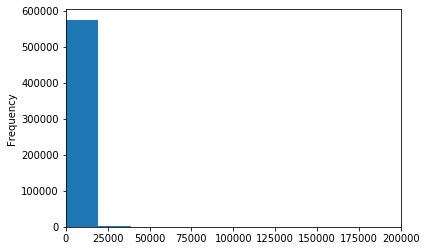

In [12]:
june13.tripduration.plot.hist(bins = 200)
plt.xlim(0, 200000)

(0, 200)

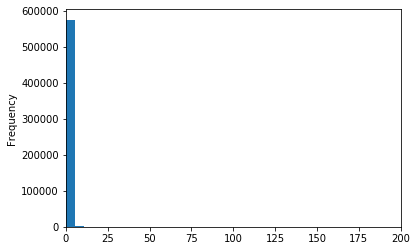

In [13]:
tripduration_hour = (june13.tripduration / 60) / 60
tripduration_hour.plot.hist(bins = 200)
plt.xlim(0, 200)

Log trip hours:

(0, 20000)

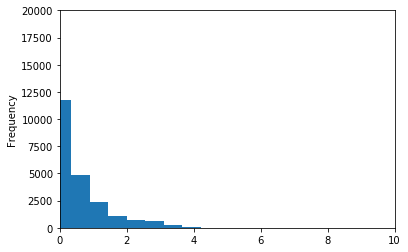

In [14]:
tripduration_hour = np.log((june13.tripduration / 60) / 60)
tripduration_hour.plot.hist(bins = 20)
plt.xlim(0, 10)
plt.ylim(0, 20000)

Log trip hours to the .25 power: 

We can see that if we wanted to utilize a linear model to predict trip duration that this now represents a more normal distributions. The skewness and kurtosis could be checked to confirm, however, there is a major difference visually. This would impact interpretability but could be reversed when making model predictions.

(0, 3500)

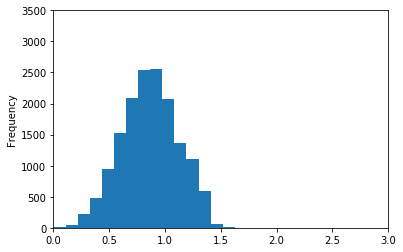

In [15]:
tripduration_hour = np.log((june13.tripduration / 60) / 60)
tripduration_hour = np.power(tripduration_hour, .25)
tripduration_hour.plot.hist(bins = 15)
plt.xlim(0, 3)
plt.ylim(0, 3500)

In [16]:
june13.tripduration.min()

61

In [17]:
june13.tripduration.max()

3876479

In [18]:
((3876479 / 60) / 60) #1076 hours

1076.7997222222223

In [19]:
june13.tripduration.mean()

1372.5702791919032

In [20]:
june13.usertype.value_counts()

Subscriber    337384
Customer      240319
Name: usertype, dtype: int64

# Combining and Sampling the Data

Initial data exploration indicated that the monthly data could be combined.

In [21]:
def combine_data(path, sample = False, fraction = None, write_csv = False, file_name = ''):
    '''
    This function will read in csv files from a path and concatenate them by row.
    If sample is indicated as True, the function will allow you to sample a fraction of each data frame.
    By default, fraction is set to 1 (100%).
    
    Similarly, write_csv = True will allow you write the newly concatenated data frame to a csv.
    The file name can be specified under file_name. 
    ------------------------------------------------------------
    Inputs:
    
        path = file path (string format)
        sample = bool, True or False
        fraction = int, the proportion of data to sample
        write_csv = bool, True or False
        file_name = string, representing the desired file name
    
    Returns:
        
        Either a csv with the given file name or a data frame.
    
    '''
    df_list = []
    
    all_files = glob.glob(os.path.join(path, '*.csv'))
    
    for file in all_files:
        if sample == True:
                df1 = pd.read_csv(file)
                df1.columns = df1.columns.str.replace(' ', '').str.lower()
                df_sample = df1.sample(frac = fraction)
                df_list.append(df_sample)
        if sample == False:
            df = pd.read_csv(file)
            df.columns = df.columns.str.replace(' ', '').str.replace(':', '').str.lower()
            df_list.append(df)
   
    concatenated_df = pd.concat(df_list, axis = 0)
    
    if write_csv:
        concatenated_df.to_csv(file_name, index = False )
    else:
        return concatenated_df

## Combining the Trip History Data

There were 79 trip history csv files spanning from June 2013 through December 2019. There are approximately 90 million Citi Bike trips during this time. In order to be able to work with this data on my machine I planned to sample the data. 

Each csv file contains 1 month of trip history data. My function, `combine_data`, was used to scan through each csv file and to sample a fraction of the data from each file. The data was appended to a list, concatenated, and then written to a single csv. I sampled $2$% of the data from each csv file. The resulting sample was approximately 1.83 million observations.

**Sample 1**
- My first sample attempt of the trip history data I noticed some issues with columns not properly matching up due to various spacing and capitalizations. I modified my `combine_data` function to correct this in the final sample version. 

**Sample 2**
- Here is where I used the modified `combine_data` function to create the second sample set after correcting the column names.
- The code is left commented out so it does not create another csv file. 

In [ ]:
#combine_data('/Users/Tyler/Desktop/projects/7_capstone/citi_bike_project/citibike_data/trip_history/', sample = True, fraction = 0.02, write_csv = True, file_name = 'sampled_trip_history2.csv')


In [22]:
sampled2 = pd.read_csv('../citibike_data/sampled_trip_history2.csv')

/Users/Tyler/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (13) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [23]:
sampled2.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender
0,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,-74.000165,29021,Subscriber,1980,2
1,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,-74.002347,29719,Subscriber,1966,2
2,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,-73.987834,16583,Subscriber,1986,1
3,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,-73.940636,26667,Customer,NaN,0
4,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,-73.988557,28812,Subscriber,1984,2


Below we confirm the sample observations and the original number of columns (15).

In [24]:
sampled2.shape

(1838885, 15)

## Combining the Ridership Data

Similar to the trip history data, I needed to combine the ridership data. The ridership data is also prepared on a monthly basis, however, it tracks the number of trips for each day, estimated miles traveled, and membership information. 

Also similar to the trip history combination, I had to remove spaces and special characters in combination with making the text lowercase for columns to match.
- The code is left commented out so it does not create another csv file. 

In [ ]:
# read_files('/Users/Tyler/Desktop/projects/7_capstone/citi_bike_project/citibike_data/ridership_all/',
#               write_csv = True, file_name = 'combined_ridership2.csv')


In [25]:
ridership2 = pd.read_csv('../citibike_data/combined_ridership2.csv')

In [26]:
ridership2.head().T

,0,1,2,3,4
date,4/1/18,4/2/18,4/3/18,4/4/18,4/5/18
tripsoverthepast24-hours(midnightto1159pm),33148,22062,25883,36755,39814
milestraveledtoday(midnightto1159pm),94040,50418,59477,80049,87382
totalannualmembers(alltime),257811,257889,257942,258025,258086
24-hourpassespurchased(midnightto1159pm),2363,297,189,611,972
3-daypassespurchased(midnightto1159pm),264,20,21,48,112
cumulativetrips(sincelaunch),NaN,NaN,NaN,NaN,NaN
milestraveledtodate,NaN,NaN,NaN,NaN,NaN
totalannualmembers,NaN,NaN,NaN,NaN,NaN
annualmembersign-ups(midnightto1159pm),NaN,NaN,NaN,NaN,NaN


In [27]:
ridership2.shape

(2206, 14)

In [28]:
ridership2.dtypes

date                                                                                 object
tripsoverthepast24-hours(midnightto1159pm)                                            int64
milestraveledtoday(midnightto1159pm)                                                float64
totalannualmembers(alltime)                                                         float64
24-hourpassespurchased(midnightto1159pm)                                             object
3-daypassespurchased(midnightto1159pm)                                              float64
cumulativetrips(sincelaunch)                                                         object
milestraveledtodate                                                                  object
totalannualmembers                                                                  float64
annualmembersign-ups(midnightto1159pm)                                               object
24-hourpassespurchased(midnightto1159pm)\t7-daypassespurchased(midnightto1159pm)

In [29]:
ridership2.columns.to_list()

['date',
 'tripsoverthepast24-hours(midnightto1159pm)',
 'milestraveledtoday(midnightto1159pm)',
 'totalannualmembers(alltime)',
 '24-hourpassespurchased(midnightto1159pm)',
 '3-daypassespurchased(midnightto1159pm)',
 'cumulativetrips(sincelaunch)',
 'milestraveledtodate',
 'totalannualmembers',
 'annualmembersign-ups(midnightto1159pm)',
 '24-hourpassespurchased(midnightto1159pm)\t7-daypassespurchased(midnightto1159pm)',
 '7-daypassespurchased(midnightto1159pm)',
 'totalannualmembershipssold',
 'column1']

**Percent missing:**

In [30]:
((np.sum(ridership2.isnull()) /  ridership2.shape[0]) * 100).sort_values()

date                                                                                 0.000000
tripsoverthepast24-hours(midnightto1159pm)                                           0.000000
milestraveledtoday(midnightto1159pm)                                                 0.000000
24-hourpassespurchased(midnightto1159pm)                                             4.170444
totalannualmembers(alltime)                                                         34.768812
cumulativetrips(sincelaunch)                                                        40.389846
milestraveledtodate                                                                 40.389846
3-daypassespurchased(midnightto1159pm)                                              47.144152
7-daypassespurchased(midnightto1159pm)                                              52.901179
annualmembersign-ups(midnightto1159pm)                                              73.526745
totalannualmembershipssold                                  

The column below contains 93 values -- all from the 2013-Q4-oct-dec data set the rest are NaN. We will drop this column and column1 since they both contain more than 95% missing. Furthermore, it is not clear what these two columns could have been combined with.

In [31]:
ridership2['24-hourpassespurchased(midnightto1159pm)\t7-daypassespurchased(midnightto1159pm)']

0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
2201   NaN
2202   NaN
2203   NaN
2204   NaN
2205   NaN
Name: 24-hourpassespurchased(midnightto1159pm)\t7-daypassespurchased(midnightto1159pm), Length: 2206, dtype: float64

In [32]:
ridership2.drop(['24-hourpassespurchased(midnightto1159pm)\t7-daypassespurchased(midnightto1159pm)', 'column1'],
               axis = 1, inplace = True)


In [33]:
ridership2.shape

(2206, 12)

**Combining Total Annual Members**

It appears there are columns containing duplicate information. For example:

$Total Annual Members + Annual Member Sign-Ups (midnight to 11:59 pm) = Total Annual Memberships Sold$

Thus, total annual members can be combined with total annual memberships sold. It appears different column names were used to capture the same information.



| Date    | Total Annual Members | Annual Member Sign-Ups (midnight to 11:59 pm) | Total Annual Memberships Sold |
|---------|----------------------|-----------------------------------------------|-------------------------------|
| 3/31/14 | 100220               | 117                                           |                               |
| 4/1/14  |                      | 174                                           | 100337                        |
| 4/2/14  |                      |                                               | 100511                        |

I combined all the total annual members columns where this could be confirmed. 

In [34]:
ridership2['totalannualmembers_combined'] = ridership2['totalannualmembers'].fillna(ridership2.totalannualmembershipssold)

ridership2['totalannualmembers_combined'] = ridership2['totalannualmembers_combined'].fillna(ridership2['totalannualmembers(alltime)'])


In [35]:
ridership2.drop(['totalannualmembers', 'totalannualmembershipssold', 'totalannualmembers(alltime)'], 
                axis = 1, inplace = True)

In [36]:
ridership2.head()

,date,tripsoverthepast24-hours(midnightto1159pm),milestraveledtoday(midnightto1159pm),24-hourpassespurchased(midnightto1159pm),3-daypassespurchased(midnightto1159pm),cumulativetrips(sincelaunch),milestraveledtodate,annualmembersign-ups(midnightto1159pm),7-daypassespurchased(midnightto1159pm),totalannualmembers_combined
0,4/1/18,33148,94040.0,2363,264.0,NaN,NaN,NaN,NaN,257811.0
1,4/2/18,22062,50418.0,297,20.0,NaN,NaN,NaN,NaN,257889.0
2,4/3/18,25883,59477.0,189,21.0,NaN,NaN,NaN,NaN,257942.0
3,4/4/18,36755,80049.0,611,48.0,NaN,NaN,NaN,NaN,258025.0
4,4/5/18,39814,87382.0,972,112.0,NaN,NaN,NaN,NaN,258086.0


Below, I wrote the cleaned data to a csv to be read in for analysis. The code was intentionally commented out so it does not run again.

In [ ]:
# ridership2.to_csv('../citibike_data/cleaned_ridership.csv', index = False)

**Checking for Seasonality**

In [61]:
from statsmodels.tsa.seasonal import seasonal_decompose
import datetime as dt

In [ ]:
sampled2.head()

In [62]:
sampled2['startdate'] = pd.to_datetime(sampled2.starttime).dt.strftime('%Y-%m-%d')

sampled2['starttime2'] = pd.to_datetime(sampled2.starttime).dt.strftime('%H:%M:%S')

sampled2['stopdate'] = pd.to_datetime(sampled2.stoptime).dt.strftime('%Y-%m-%d')

sampled2['stoptime2'] = pd.to_datetime(sampled2.stoptime).dt.strftime('%H:%M:%S')

In [63]:
season_test = sampled2.copy().set_index('startdate')

In [64]:
season_test.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,endstationlongitude,bikeid,usertype,birthyear,gender,starttime2,stopdate,stoptime2
startdate,,,,,,,,,,,,,,,,,,
2017-09-25,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,-74.000165,29021,Subscriber,1980,2,13:59:44,2017-09-25,14:10:56
2017-09-11,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,-74.002347,29719,Subscriber,1966,2,08:14:44,2017-09-11,08:27:27
2017-09-01,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,-73.987834,16583,Subscriber,1986,1,12:37:12,2017-09-01,12:52:21
2017-09-05,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,-73.940636,26667,Customer,NaN,0,19:35:46,2017-09-05,19:41:56
2017-09-26,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,-73.988557,28812,Subscriber,1984,2,09:10:07,2017-09-26,09:24:39


In [ ]:
np.sum(season_test.isnull())

In [65]:
season_test['bike_trip'] = 1

In [ ]:
season_test.groupby([season_test.index]).count()

In [ ]:
season_test.groupby([season_test.index])['bike_trip'].sum().plot()
plt.xticks()

In [ ]:
season_test.groupby(['stopdate'])['bike_trip'].sum().plot()

In [ ]:
season_test.groupby([season_test.index])['bike_trip'].sum().plot.hist(30)

In [ ]:
season_trips_transform = season_test.groupby([season_test.index])['bike_trip'].sum()

In [ ]:
(season_trips_transform**.65).plot.hist(30)

In [ ]:
season_dt = season_test[['bike_trip']]
dt_group = season_dt.groupby(season_dt.index)['bike_trip'].sum()

In [ ]:
from pylab import rcParams
rcParams['figure.figsize'] = 10, 5


start_season = seasonal_decompose(dt_group, model = 'additive', period = 365)

start_season.plot()

plt.show()

In [ ]:
rcParams['figure.figsize'] = 10, 5

start_season = seasonal_decompose(dt_group, model = 'multiplicative', period = 365)

start_season.plot()

plt.show()

In [ ]:
start_season.plot()
plt.xticks(np.arange(12))
plt.show()

In [ ]:
ridership2.head()

## Central Park Weather


In [ ]:
min(sampled2.startdate)

In [ ]:
max(sampled2.startdate)

- AWND = Average daily wind speed (meters per second or miles per hour as per user preference)
- PRCP = Precipitation (mm or inches as per user preference, inches to hundredths on Daily Form pdf file) 
- SNOW = Snowfall (mm or inches as per user preference, inches to tenths on Daily Form pdf file)
- SNWD = Snow depth (mm or inches as per user preference, inches on Daily Form pdf file)
- average of hourly temperature values (TAVG)
- TMAX = Maximum temperature (Fahrenheit or Celsius as per user preference, Fahrenheit to tenths on Daily Form pdf file
- TMIN = Minimum temperature (Fahrenheit or Celsius as per user preference, Fahrenheit to tenths on Daily Form pdf file
- TSUN = Daily total sunshine (minutes)
- weather type:
    - 01 = Fog, ice fog, or freezing fog (may include heavy fog) 
    - 02 = Heavy fog or heaving freezing fog (not always distinguished from fog) 
    - 03 = Thunder
    - 04 = Ice pellets, sleet, snow pellets, or small hail
    - 06 = Glaze or rime 
    - 08 = Smoke or haze

In [66]:
cpw = pd.read_csv('../citibike_data/cpw.csv', sep = ',')
cpw.columns = map(str.lower, cpw.columns)
cpw.head()

,station,name,latitude,longitude,elevation,date,awnd,prcp,snow,snwd,tavg,tmax,tmin,tsun,wt01,wt02,wt03,wt04,wt06,wt08
0,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-01,3.80,0.00,0.0,0.0,NaN,90,73,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-02,6.04,0.85,0.0,0.0,NaN,88,69,NaN,1.0,NaN,NaN,NaN,NaN,NaN
2,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-03,3.36,0.87,0.0,0.0,NaN,78,66,NaN,1.0,NaN,NaN,NaN,NaN,NaN
3,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-04,4.92,0.00,0.0,0.0,NaN,75,57,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,USW00094728,"NY CITY CENTRAL PARK, NY US",40.77898,-73.96925,42.7,2013-06-05,3.80,0.00,0.0,0.0,NaN,74,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [67]:
cpw_date = cpw.copy()
cpw_date.date = pd.to_datetime(cpw_date.date)

In [68]:
cpw_date.dtypes

station              object
name                 object
latitude            float64
longitude           float64
elevation           float64
date         datetime64[ns]
awnd                float64
prcp                float64
snow                float64
snwd                float64
tavg                float64
tmax                  int64
tmin                  int64
tsun                float64
wt01                float64
wt02                float64
wt03                float64
wt04                float64
wt06                float64
wt08                float64
dtype: object

In [69]:
np.sum(cpw_date.isnull())

station         0
name            0
latitude        0
longitude       0
elevation       0
date            0
awnd          166
prcp            0
snow            1
snwd            0
tavg         2405
tmax            0
tmin            0
tsun         2404
wt01         1584
wt02         2359
wt03         2350
wt04         2400
wt06         2391
wt08         1955
dtype: int64

Checks for missing data or data not received indicated by the documentation

In [70]:
print('NA in prcp:', np.sum(cpw['prcp'] == 9999))
print('NA in snow:', np.sum(cpw['snow'] == 9999))
print('NA in snwd:', np.sum(cpw['snwd'] == 9999))
print('NA in tmax:', np.sum(cpw['tmax'] == 9999))
print('NA in tmin:', np.sum(cpw['tmin'] == 9999))

NA in prcp: 0
NA in snow: 0
NA in snwd: 0
NA in tmax: 0
NA in tmin: 0


In [71]:
rcParams['figure.figsize'] = 15, 6

plt.plot('date', 'tmax', data = cpw, color = 'red',)
plt.plot('date', 'tmin', data = cpw, color = 'skyblue')
plt.xlabel('Date')
plt.ylabel('Temperature (Fahrenheit)')
plt.xticks(np.arange(0, 2406, 182.5), rotation = 90)

NameError: name 'rcParams' is not defined

In [72]:
cpw_month = cpw_date.set_index('date').groupby(pd.Grouper(freq='M'))

In [73]:
avg_temp = cpw_month[['tmax', 'tmin']].agg('mean')

In [74]:
import matplotlib.dates as mdates

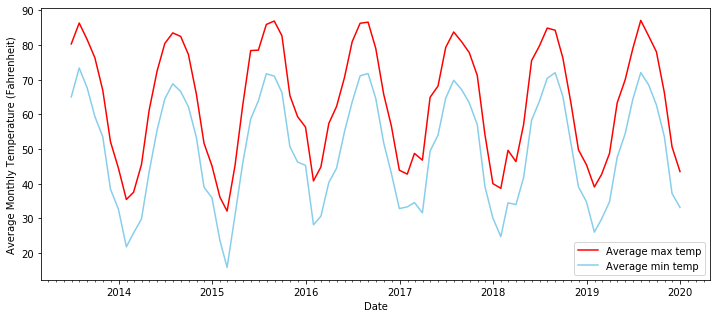

In [75]:
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# the plot
fig, ax= plt.subplots(figsize = (12, 5))
ax.plot('tmax', data = avg_temp, color = 'red')
ax.plot('tmin', data = avg_temp, color = 'skyblue')

#axis & legend labels
plt.xlabel('Date')
plt.ylabel('Average Monthly Temperature (Fahrenheit)')
plt.legend(loc = 4, labels = ['Average max temp', 'Average min temp'])

ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)

plt.show()

In [ ]:
season_test.head()

In [76]:
bike_test = season_test.reset_index().copy()
bike_test['startdate'] = pd.to_datetime(bike_test.startdate)

bike_test.set_index('startdate', inplace = True)

#bike_test.head()

bike_group = bike_test[['bike_trip']].groupby(pd.Grouper(freq = 'M')).sum()

In [ ]:
bike_group.head()

In [ ]:
bike_group.plot()

In [ ]:
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

## the plot
fig, ax= plt.subplots(figsize = (12, 5))

tmax = ax.plot('tmax', data = avg_temp, color = 'red')
tmin = ax.plot('tmin', data = avg_temp, color = 'skyblue')

## axis & legend labels
plt.xlabel('Date')
plt.ylabel('Average Monthly Temperature (Fahrenheit)')
#plt.legend(loc = 4, labels = ['Average max temp', 'Average min temp'])

ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)

ax2 = ax.twinx()
nrides = ax2.plot('bike_trip', data = bike_group, color = 'black')
ax2.set_ylabel('Number of Rides')
# ax2.legend(loc = 3, labels = ['Number of rides'])

lns = tmax+tmin+nrides
labs = ['Average max temp', 'Average min temp', 'Number of rides']
ax.legend(lns, labs, loc=4)
#ax.legend(lns, loc = 4, labels = ['Average max temp', 'Average min temp', 'Number of rides'])

plt.show()

## Bike Trip Map

In [37]:
sampled_trips = sampled2.copy()
sampled_trips['bike_trip'] = 1

In [38]:
##using head(100)
##startstation_freq = sampled_trips[['startstationname','bike_trip']].groupby('startstationname').count().sort_values(by = 'bike_trip', ascending = False).head(100)

## all records
startstation_freq = sampled_trips[['startstationname','bike_trip']].groupby('startstationname').count().sort_values(by = 'bike_trip', ascending = False)
startstation_freq.reset_index(inplace = True)
startstation_freq

,startstationname,bike_trip
0,Pershing Square North,15029
1,E 17 St & Broadway,13170
2,W 21 St & 6 Ave,12341
3,8 Ave & W 31 St,12118
4,Broadway & E 22 St,11956
...,...,...
1059,Onderdonk Ave & Gates Ave,1
1060,Prospect Park - 5 Year Anniversary Celebration,1
1061,Cypress Ave & Palmetto St,1
1062,Cypress Ave & George St,1


In [39]:
lat_long = sampled_trips[['startstationname','startstationlatitude','startstationlongitude']]


In [40]:
startgis_df = pd.merge(startstation_freq, lat_long, how = 'left', on = 'startstationname')
startgis_df = startgis_df.groupby('startstationname').first().reset_index()
startgis_df.sort_values(by = 'bike_trip', ascending = False)

,startstationname,bike_trip,startstationlatitude,startstationlongitude
793,Pershing Square North,15029,40.751873,-73.977706
403,E 17 St & Broadway,13170,40.737050,-73.990093
950,W 21 St & 6 Ave,12341,40.741740,-73.994156
144,8 Ave & W 31 St,12118,40.750585,-73.994685
216,Broadway & E 22 St,11956,40.740343,-73.989551
...,...,...,...,...
773,Onderdonk Ave & Gates Ave,1,40.704130,-73.907370
809,Prospect Park - 5 Year Anniversary Celebration,1,40.660652,-73.964590
341,Cypress Ave & Palmetto St,1,40.701573,-73.908763
340,Cypress Ave & George St,1,40.698120,-73.902710


In [41]:
# colors = [
#     'red',
#     'blue',
#     'gray',
#     'darkred',
#     'lightred',
#     'orange',
#     'beige',
#     'green',
#     'darkgreen',
#     'lightgreen',
#     'darkblue',
#     'lightblue',
#     'purple',
#     'darkpurple',
#     'pink',
#     'cadetblue',
#     'lightgray',
#     'black'
# ]

In [42]:
def colors(trips):
    if trips > 10000:
        return 'darkpurple'
    elif trips > 5000:
        return 'darkblue'
    elif trips > 1000:
        return 'darkgreen'
    else:
        return 'darkred'

In [43]:
startgis_df.head()

,startstationname,bike_trip,startstationlatitude,startstationlongitude
0,1 Ave & E 110 St,524,40.792327,-73.938300
1,1 Ave & E 15 St,3121,40.732219,-73.981656
2,1 Ave & E 16 St,4963,40.732219,-73.981656
3,1 Ave & E 18 St,5355,40.733812,-73.980544
4,1 Ave & E 30 St,5238,40.741444,-73.975361


In [44]:
startgis_df.loc[startgis_df.startstationname == "Hs Don't Use", 'startstationname']

612    Hs Don't Use
Name: startstationname, dtype: object

In [45]:
startgis_df.loc[startgis_df.startstationname == "Hs Don't Use", 'startstationname'] = u"São Paulo Hs Don't Use"

In [46]:
startgis_df.loc[startgis_df.startstationname == "São Paulo Hs Don't Use"]

,startstationname,bike_trip,startstationlatitude,startstationlongitude
612,São Paulo Hs Don't Use,1,40.719252,-74.034234


In [47]:
cop = startgis_df.copy()

In [48]:
cop.iloc[[612]]

,startstationname,bike_trip,startstationlatitude,startstationlongitude
612,São Paulo Hs Don't Use,1,40.719252,-74.034234


In [49]:
cop.drop(axis = 0, index = 612, inplace = True)

In [50]:
boroughs_path = "../citibike_data/Borough_Boundaries/Borough_Boundaries.geojson"


**Initial Cluster Marker Map**

In [51]:
import folium
from folium.plugins import FastMarkerCluster, MarkerCluster  

## tiles = CartoDB dark_matter; 'OpenStreetMap'
manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "cartodbpositron")

mc = MarkerCluster(name = "Marker Cluster")

for index, row in startgis_df.iterrows():
    popup_text = "Station: {}, Trips: {}".format(
                      row["startstationname"],
                      row["bike_trip"])
    folium.CircleMarker(location=[row["startstationlatitude"],row["startstationlongitude"]],
                        radius= 5,
                        color="green",
                        popup=popup_text,
                        fill=True).add_to(mc)
    
folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)    

mc.add_to(manhattan)

folium.LayerControl().add_to(manhattan)

manhattan

**Marker Cluster 2**

In [52]:
# startstationname	bike_trip	startstationlatitude	startstationlongitude

In [53]:
startname = list(startgis_df.startstationname)
start_trips = list(startgis_df.bike_trip)
start_lat = list(startgis_df.startstationlatitude)
start_lon = list(startgis_df.startstationlongitude)

In [54]:
popup_text = "Station: {}, Trips: {}".format(
                      startgis_df["startstationname"],
                      startgis_df["bike_trip"])
    
#     str(name)+": "+ str(trip)

In [55]:
## tiles = CartoDB dark_matter; 'OpenStreetMap'

manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "OpenStreetMap")

mc = MarkerCluster(name = "Marker Cluster")

for index, row in startgis_df.iterrows():
    popup_text = "Station: {}, Trips: {}".format(
                      row["startstationname"],
                      row["bike_trip"])
    
    folium.CircleMarker(location=[row['startstationlatitude'], row['startstationlongitude']], 
                                     radius = 6, 
                                     popup=popup_text,
                                     fill_color=colors(row['bike_trip']), 
                                     color = 'grey', 
                                     fill_opacity=0.6).add_to(mc)
    
folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)    

mc.add_to(manhattan)

folium.LayerControl().add_to(manhattan)

manhattan

In [56]:
## tiles = CartoDB dark_matter; 'OpenStreetMap'

manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "cartodbpositron")

fg = folium.FeatureGroup(name="My Map")

for index, row in startgis_df.iterrows():
    popup_text = "Station: {}, Trips: {}".format(
                      row["startstationname"],
                      row["bike_trip"])
    
    
    folium.CircleMarker(location=[row['startstationlatitude'], row['startstationlongitude']], 
                                     radius = 6, 
                                     popup=popup_text,
                                     fill_color=colors(row['bike_trip']), 
                                     color = 'grey', 
                                     fill_opacity=0.6).add_to(fg)
    
folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)

manhattan.add_child(fg)

folium.LayerControl().add_to(manhattan)

manhattan

In [57]:
from folium.plugins import HeatMap

## tiles = CartoDB dark_matter #OpenStreetMap
manhattan = folium.Map(location = [40.758896, -73.985130], zoom_start = 12, tiles = "OpenStreetMap")


heat_data = [[row['startstationlatitude'], row['startstationlongitude']] for index, row in startgis_df.iterrows()]

folium.GeoJson(
    boroughs_path,
    name='boroughs'
).add_to(manhattan)

HeatMap(heat_data, min_opacity = 0.5).add_to(manhattan)

manhattan

## Notes:

**Rolling averages** are a way to smooth data
- You average over time;
    - smooths by average
    - 1D conv. NN
- Essentially, you take the average of 4 elements and roll over 1 place and average those 4 elements (minus the first 1 etc.)

**Number of Unique Bikes** can be used as a proxy for normalization

In [58]:
# season_test.groupby(pd.Grouper(freq = 'M'))['bikeid'].nunique()

In [78]:
bike_test.groupby(bike_test.index)['bikeid'].value_counts()

startdate   bikeid
2013-06-01  15015     2
            15647     2
            17910     2
            19402     2
            19411     2
                     ..
2019-12-31  41997     1
            42021     1
            42028     1
            42038     1
            42040     1
Name: bikeid, Length: 1690686, dtype: int64

In [79]:
bike_test.groupby(bike_test.index)['bikeid'].nunique()

startdate
2013-06-01    154
2013-06-02    285
2013-06-03    123
2013-06-04    288
2013-06-05    306
             ... 
2019-12-27    616
2019-12-28    539
2019-12-29    338
2019-12-30    227
2019-12-31    589
Name: bikeid, Length: 2397, dtype: int64

## Number of starting bike trips per hour

In [80]:
sampled2.startdate = pd.to_datetime(sampled2.startdate)

sampled2.stopdate = pd.to_datetime(sampled2.stopdate)

In [81]:
sampled2['bike_trip'] = 1

In [82]:
sampled2['start_hour'] = pd.to_datetime(sampled2.starttime2).dt.hour

sampled2['stop_hour'] = pd.to_datetime(sampled2.stoptime2).dt.hour

In [83]:
start_df = pd.DataFrame(sampled2[['start_hour', 'bike_trip']].groupby('start_hour')['bike_trip'].sum()).reset_index()

stop_df = pd.DataFrame(sampled2[['stop_hour', 'bike_trip']].groupby('stop_hour')['bike_trip'].sum()).reset_index()

Text(0.5, 1.0, 'Frequency of trips by starting hour')

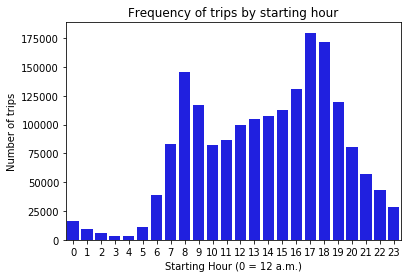

In [84]:
sns.barplot(x = 'start_hour', y = 'bike_trip', data = start_df, color = 'blue')
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Number of trips')
plt.title('Frequency of trips by starting hour')

Text(0.5, 1.0, 'Frequency of trips by stopping hour')

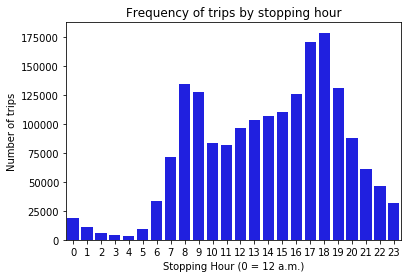

In [85]:
sns.barplot(x = 'stop_hour', y = 'bike_trip', data = stop_df, color = 'blue')
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Number of trips')
plt.title('Frequency of trips by stopping hour')

In [86]:
start_gender = pd.DataFrame(sampled2[['start_hour', 'bike_trip', 'gender', 'usertype']].groupby(['start_hour', 'gender'])['bike_trip'].sum()).reset_index()

stop_gender = pd.DataFrame(sampled2[['stop_hour', 'bike_trip', 'gender', 'usertype']].groupby(['stop_hour', 'gender'])['bike_trip'].sum()).reset_index()

In [87]:
start_gender['proportion'] = start_gender.bike_trip / sum(start_gender.bike_trip)

stop_gender['proportion'] = stop_gender.bike_trip / sum(stop_gender.bike_trip)

Text(0.5, 1.0, 'Proportion of trips by starting hour and genger')

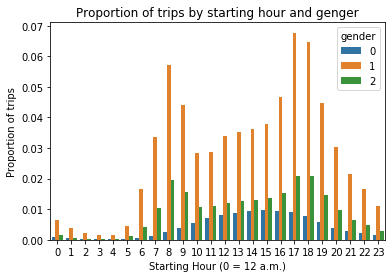

In [88]:
sns.barplot(x = 'start_hour', y = 'proportion', hue = 'gender', data = start_gender)
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and genger')

Text(0.5, 1.0, 'Proportion of trips by stopping hour and genger')

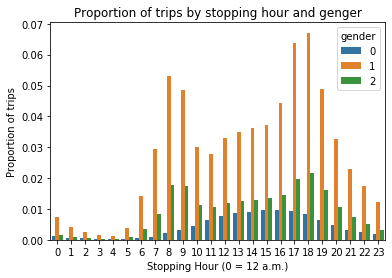

In [89]:
sns.barplot(x = 'stop_hour', y = 'proportion', hue = 'gender', data = stop_gender)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by stopping hour and genger')

In [90]:
start_type = pd.DataFrame(sampled2[['start_hour', 'bike_trip', 'usertype']].groupby(['start_hour', 'usertype'])['bike_trip'].sum()).reset_index()

stop_type = pd.DataFrame(sampled2[['stop_hour', 'bike_trip', 'usertype']].groupby(['stop_hour', 'usertype'])['bike_trip'].sum()).reset_index()

In [91]:
start_type['proportion'] = start_type.bike_trip / sum(start_type.bike_trip)

stop_type['proportion'] = stop_type.bike_trip / sum(stop_type.bike_trip)

Text(0.5, 1.0, 'Proportion of trips by starting hour and usertype')

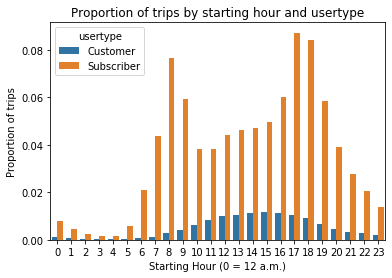

In [92]:
sns.barplot(x = 'start_hour', y = 'proportion', hue = 'usertype', data = start_type)
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and usertype')

Text(0.5, 1.0, 'Proportion of trips by stopping hour and usertype')

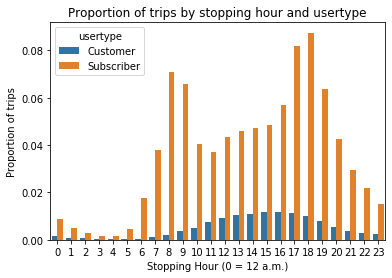

In [93]:
sns.barplot(x = 'stop_hour', y = 'proportion', hue = 'usertype', data = stop_type)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by stopping hour and usertype')

## Day of the Week

In [94]:
sampled2.head()

,tripduration,starttime,stoptime,startstationid,startstationname,startstationlatitude,startstationlongitude,endstationid,endstationname,endstationlatitude,...,usertype,birthyear,gender,startdate,starttime2,stopdate,stoptime2,bike_trip,start_hour,stop_hour
0,671,2017-09-25 13:59:44,2017-09-25 14:10:56,341.0,Stanton St & Mangin St,40.717821,-73.976289,82.0,St James Pl & Pearl St,40.711174,...,Subscriber,1980,2,2017-09-25,13:59:44,2017-09-25,14:10:56,1,13,14
1,763,2017-09-11 08:14:44,2017-09-11 08:27:27,403.0,E 2 St & 2 Ave,40.725029,-73.990697,2010.0,Grand St & Greene St,40.721655,...,Subscriber,1966,2,2017-09-11,08:14:44,2017-09-11,08:27:27,1,8,8
2,908,2017-09-01 12:37:12,2017-09-01 12:52:21,359.0,E 47 St & Park Ave,40.755103,-73.974987,428.0,E 3 St & 1 Ave,40.724677,...,Subscriber,1986,1,2017-09-01,12:37:12,2017-09-01,12:52:21,1,12,12
3,370,2017-09-05 19:35:46,2017-09-05 19:41:56,3076.0,Scholes St & Manhattan Ave,40.708704,-73.944862,3068.0,Humboldt St & Varet St,40.703172,...,Customer,NaN,0,2017-09-05,19:35:46,2017-09-05,19:41:56,1,19,19
4,871,2017-09-26 09:10:07,2017-09-26 09:24:39,487.0,E 20 St & FDR Drive,40.733143,-73.975739,486.0,Broadway & W 29 St,40.746201,...,Subscriber,1984,2,2017-09-26,09:10:07,2017-09-26,09:24:39,1,9,9


In [95]:
# sampled2.startdate = pd.to_datetime(sampled2.startdate)

# sampled2.stopdate = pd.to_datetime(sampled2.stopdate)

In [96]:
# sampled2['bike_trip'] = 1

In [97]:
sampled2['start_day'] = sampled2.startdate.dt.dayofweek

In [98]:
day_df = pd.DataFrame(sampled2.groupby('start_day')['bike_trip'].sum()).reset_index()

In [99]:
day_df.head()

,start_day,bike_trip
0,0,263344
1,1,279765
2,2,290440
3,3,282345
4,4,274211


In [100]:


#lambda x : x*2 if x < 10 else (x*3 if x < 20 else x)



([<matplotlib.axis.XTick at 0x1a672b9a90>,
 <a list of 7 Text xticklabel objects>)

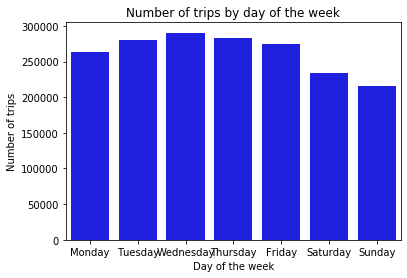

In [101]:
sns.barplot(x = 'start_day', y = 'bike_trip', data = day_df, color = 'blue')

plt.xlabel('Day of the week')
plt.ylabel('Number of trips')
plt.title('Number of trips by day of the week')

plt.xticks(ticks = np.arange(7), labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])


In [102]:
day_df['weekend'] = np.where(day_df['start_day'] >=5, 'weekend', 'weekday')

In [103]:
day_df.groupby('weekend')['bike_trip'].sum()

weekend
weekday    1390105
weekend     448780
Name: bike_trip, dtype: int64

In [104]:
start_day_hour = sampled2[['start_day', 'start_hour', 'bike_trip']]

In [105]:
start_day_hour['weekend'] = np.where(start_day_hour['start_day'] >=5, 'weekend', 'weekday')

/Users/Tyler/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [106]:
sdh_plot = start_day_hour.groupby(['start_hour','weekend'])['bike_trip'].sum()


In [107]:
sdh_plot = pd.DataFrame(sdh_plot)

In [108]:
sdh_plot['proportion'] = sdh_plot.bike_trip / sum(sdh_plot.bike_trip)

sdh_plot.reset_index(inplace = True)

In [109]:
sdh_plot.groupby('weekend')['proportion'].sum()

weekend
weekday    0.75595
weekend    0.24405
Name: proportion, dtype: float64

Text(0, 0.5, 'Number of trips')

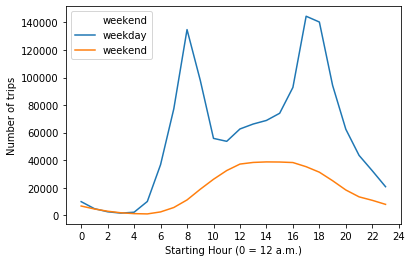

In [110]:
sns.lineplot(x = 'start_hour', y = 'bike_trip', hue = 'weekend', data = sdh_plot)
plt.xticks(np.arange(0,25,2))
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Number of trips')

Text(0, 0.5, 'Proportion of trips')

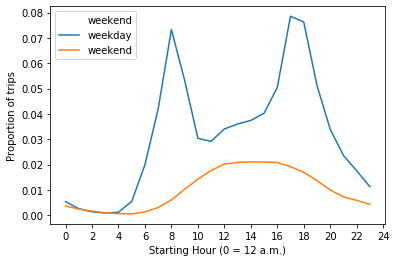

In [111]:
sns.lineplot(x = 'start_hour', y = 'proportion', hue = 'weekend', data = sdh_plot)
plt.xticks(np.arange(0,25,2))
plt.xlabel('Starting Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')

Text(0.5, 1.0, 'Proportion of trips by starting hour and weekday or weekend')

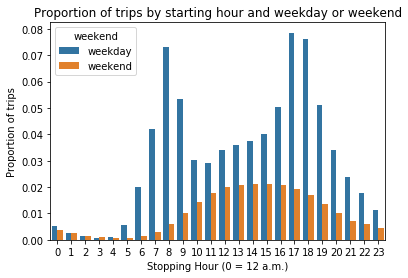

In [112]:
sns.barplot(x = 'start_hour', y = 'proportion', hue = 'weekend', data = sdh_plot)
plt.xlabel('Stopping Hour (0 = 12 a.m.)')
plt.ylabel('Proportion of trips')
plt.title('Proportion of trips by starting hour and weekday or weekend')